<a href="https://colab.research.google.com/github/kamilakesbi/notebooks/blob/main/fine_tune_pyannote.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 🤗 Fine-tune pyannote's segmentation model for multinlingual speaker diarization

In this colab, we present a step-by-step guide on how to fine-tune a speaker segmentation model from [pyannote](https://github.com/pyannote/pyannote-audio) on multilingual speaker diarization datasets using [diarizers](https://github.com/huggingface/diarizers), a library compatible with the Hugging Face 🤗  ecosystem, and use it back in a speaker diarization pipeline.

With as little as 20 hours of diarization data and 10 minutes of GPU compute, we improve the relative performance of the diarization segmentation model by 29% on Japanese conversational data.


## Introduction

Speaker diarization is the process of dividing an audio stream containing human speech into homogeneous segments according to the identity of each speaker. These models aim to answer the question: $\textit{who spoke when?}$.  

[pyannote](https://github.com/pyannote/pyannote-audio) is an open source toolkit for speaker diarization in python. It comes with state-of-the-art pretrained models and pipelines that are available on the [Hugging Face Hub](https://huggingface.co/pyannote).


[pyannote/speaker-diarization-3.1](https://huggingface.co/pyannote/speaker-diarization-3.1) is the main pyannote pipeline used for speaker diarization. This system is explained in the paper [Powerset multi-class cross entropy loss for neural speaker diarization](https://arxiv.org/pdf/2310.13025.pdf) (Alexis Plaquet and Hervé Bredin, 2023). It is based on several steps:

- First, it splits long conversations into shorter chunks.

- Second, it uses a $\textbf{segmentation model}$, [pyannote/segmentation-3.0](https://huggingface.co/pyannote/segmentation-3.0), to perform speaker diarization at the chunk level.

- Finally, the segmented chunks are stitched back together using a $\textbf{speaker embedding}$ model ([pyannote/wespeaker-voxceleb-resnet34-LM](https://huggingface.co/pyannote/wespeaker-voxceleb-resnet34-LM)) and a $\textbf{clustering algorithm}$ (AgglomerativeClustering).

The segmentation model has been trained on a combination of datasets containing mostly English and Mandarin languages. As a consequence, the performance of the speaker diarization pipeline may decrease when confronted with out-of-distribution data, such as Spanish or Japanese.

## Motivation

We introduce [diarizers](https://github.com/huggingface/diarizers), a library compatible with the Hugging Face ecosystem which can be used to fine-tune pyannote's [segmentation model](https://huggingface.co/pyannote/segmentation-3.0).

In this notebook, we show how to use this library to:

1. Load a speaker diarization dataset from the Hugging Face Hub.

2. Load a pre-trained segmentation model and fine-tune it with as little as twenty hours of labelled diarization data and 10 minutes of GPU computing time.

3. Evaluate the model on full meetings recordings (at inference time).

4. Convert it back to a pyannote compatible format and use it in a speaker diarization pipeline.

In this notebook, we fine-tune more specifically the segmentation model in Japanese using the $\textbf{Callhome}$ dataset available in [diarizers-community](https://huggingface.co/diarizers-community). We improve the resulting Diarisation Error Rate (DER) from 27% to 19%.

To run a more streamlined version of the script, refer to the [Training Section](https://github.com/huggingface/diarizers#train) of the diarizers README.

## Prepare environement

First of all, let's try to secure a decent GPU for our Colab! Unfortunately, it's becoming much harder to get access to a good GPU with the free version of Google Colab. However, with Google Colab Pro one should have no issues in being allocated a V100 or P100 GPU.

To get a GPU, click Runtime -> Change runtime type, then change Hardware accelerator from CPU to one of the available GPUs, e.g. T4 (or better if you have one available). Next, click Connect T4 in the top right-hand corner of your screen (or Connect {V100, A100} if you selected a different GPU).

We can verify that we've been assigned a GPU and view its specifications:

In [ ]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Sat Apr 20 16:18:03 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA L4                      Off | 00000000:00:03.0 Off |                    0 |
| N/A   73C    P8              20W /  72W |      1MiB / 23034MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

This `diarizers` library includes dependencies to `transformers`, `datasets`, `accelerate`, `pyannote.audio` and `torch`. We will need all these dependencies to run this notebook.

To install them all, simply run the following line of code, which will install the `diarizers` package:

In [ ]:
!pip install --upgrade --quiet git+https://github.com/huggingface/diarizers.git

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


To load pre-trained diarization models from the Hub, you'll first need to accept the terms-of-use for the following two models:

- [pyannote/segmentation-3.0](https://huggingface.co/pyannote/segmentation-3.0)
- [pyannote/speaker-diarization-3.1](https://huggingface.co/pyannote/speaker-diarization-3.1)

To load the CallHome dataset from the Hub, you'll also need to accept its terms of use:

- [diarizers-community/callhome](https://huggingface.co/datasets/diarizers-community/callhome)

You'll then need to enter your
Hub authentication token. Find your Hub authentication token [here](https://huggingface.co/settings/tokens).

In [ ]:
from huggingface_hub import notebook_login

notebook_login()

# Load a dataset:

Using 🤗 Datasets, downloading and preparing speaker diarization datasets is extremely simple. We integrated several multilingual speaker diarization datasets in [diarizers-community](https://huggingface.co/diarizers-community). These datasets can be used to fine-tune the segmentation model in Japanese, Spanish, German, Chinese, French and English. All of these dataset can be downloaded using a single line of code.

In this notebook, we will use the Japanese Callhome dataset to fine-tune the segmentation model for Japanese. We encourage you to swap the dataset for one in your choice of language!

In [ ]:
from datasets import load_dataset

dataset = load_dataset('diarizers-community/callhome', 'jpn')

Let's inspect the dataset we've downloaded:

In [ ]:
dataset

DatasetDict({
    data: Dataset({
        features: ['audio', 'timestamps_start', 'timestamps_end', 'speakers'],
        num_rows: 120
    })
})

As we can see, this dataset contains four features:

- `audio`: Audio feature with audios samples at 16kHz.
- `speakers`: The list of audio speakers, with their order of appearance.
- `timestamps_start`: A list of timestamps indicating the start of each speaker segment.
- `timestamps_end`: A list of timestamps indicating the end of each speaker segment.

These are the features we want to have in our speaker diarisation dataset to make it compatible with `diarizers`. As for the callhome dataset, all the other speaker diarization datasets present in [diarizers-community](https://huggingface.co/diarizers-community) come with these features.

If a dataset in your choice of language isn't present on the Hub, you can convert one yourself using the [instructions in diarizers](https://github.com/huggingface/diarizers/blob/main/datasets/README.md).


Let's listen to a first example from the callhome dataset:

In [ ]:
from IPython.display import Audio, display

example = dataset["data"][0]

In [ ]:
print(display(Audio(example['audio']['array'], rate=example['audio']['sampling_rate'])))
print('Speakers: ', example['speakers'])
print('timestamps_start: ', example['timestamps_start'])
print('timestamps_end: ', example['timestamps_end'])

None
Speakers:  ['B', 'A', 'A', 'B', 'A', 'B', 'A', 'B', 'A', 'B', 'B', 'A', 'B', 'A', 'B', 'A', 'B', 'B', 'A', 'B', 'A', 'B', 'A', 'B', 'A', 'B', 'A', 'B', 'A', 'A', 'A', 'B', 'A', 'B', 'A', 'B', 'B', 'A', 'B', 'B', 'A', 'B', 'A', 'B', 'A', 'B', 'A', 'B', 'B', 'A', 'B', 'A', 'B', 'A', 'B', 'A', 'B', 'A', 'B', 'A', 'B', 'B', 'A', 'B', 'B', 'A', 'B', 'A', 'B', 'B', 'A', 'B', 'B', 'A', 'B', 'A', 'A', 'B', 'B', 'A', 'B', 'B', 'A', 'B', 'B', 'A', 'B', 'A', 'B', 'A', 'B', 'A', 'B', 'A', 'B', 'A', 'B', 'A', 'A', 'B', 'B', 'A', 'B', 'A', 'B', 'A', 'B', 'A', 'B', 'B', 'A', 'B', 'A', 'B', 'A', 'B', 'A', 'B', 'A', 'B', 'B', 'A', 'B', 'A', 'B', 'A', 'B', 'A', 'B', 'A', 'B', 'B', 'A', 'B', 'A', 'B', 'B', 'A', 'B', 'A', 'B', 'B', 'A', 'A', 'B', 'A', 'B', 'A', 'B', 'A', 'B', 'B', 'A', 'B', 'A', 'B', 'A', 'B', 'A', 'B', 'A', 'B', 'A', 'B', 'A', 'B', 'B', 'A', 'B', 'B', 'A', 'B', 'A', 'B', 'A', 'B', 'A', 'B', 'A', 'B', 'A', 'B', 'A', 'B', 'A', 'B', 'A', 'B', 'B', 'A', 'A', 'B', 'A', 'B', 'A', 'B', 'B'

As you can hear, there are two speakers in this conversation: A and B. The audio alternates between speakers A and B according to the timestamp start and end times. The speaker segments are quite short, typically lasting only a few seconds. This is typical of a conversational telephone dataset, like Callhome.

The Callhome dataset doesn't come with a predefined train-val-test split. Here, we use the `train_test_split` method from 🤗 Datasets to split it with 80-10-10 proportion:

In [ ]:
from datasets import DatasetDict

train_testvalid = dataset['data'].train_test_split(test_size=0.2, seed=0)
test_valid = train_testvalid['test'].train_test_split(test_size=0.5, seed=0)

dataset = DatasetDict({
    'train': train_testvalid['train'],
    'validation': test_valid['test'],
    'test': test_valid['train']}
)

In [ ]:
dataset

DatasetDict({
    train: Dataset({
        features: ['audio', 'timestamps_start', 'timestamps_end', 'speakers'],
        num_rows: 96
    })
    validation: Dataset({
        features: ['audio', 'timestamps_start', 'timestamps_end', 'speakers'],
        num_rows: 12
    })
    test: Dataset({
        features: ['audio', 'timestamps_start', 'timestamps_end', 'speakers'],
        num_rows: 12
    })
})

# Load the pretrained model

Let's load the pretrained segmentation-model model we want to fine-tune. We can load the pre-trained weights from the Hugging Face Hub using the `.from_pretrained` method. We will use its configuration to know how we should preprocess our dataset.

In [ ]:
from pyannote.audio import Model

pretrained = Model.from_pretrained(
  "pyannote/segmentation-3.0",
  use_auth_token=True
)

To fine-tune the pretrained segmentation model with the Hugging Face Trainer, we need to export it to the `diarizers` modelling class `SegmentationModel`. This class is a convenient wrapper around the pyannote segmentation model that enables compatibility with the Trainer by ensuring the correct input arguments and returning the expected output format.


We can load `pyannote`'s pretrained model weights, architecture and configuration into a `SegmentationModel` using the next line of code:

In [ ]:
from diarizers import SegmentationModel

model = SegmentationModel.from_pyannote_model(pretrained)

Let's visualise the configuration used by the pretrained model:

In [ ]:
model.config

SegmentationModelConfig {
  "chunk_duration": 10.0,
  "max_speakers_per_chunk": 3,
  "max_speakers_per_frame": 2,
  "min_duration": null,
  "model_type": "pyannet",
  "sample_rate": 16000,
  "transformers_version": "4.40.0",
  "warm_up": [
    0.0,
    0.0
  ],
  "weigh_by_cardinality": false
}

Among the interesting attributes, we can list:

- `chunk_duration`: specifies the audio chunk duration that the segmentation model can take as input. Default is 10.
- `max_speakers_per_chunk`: specifies the maximum number of speakers the model can predict on each audio chunk.
- `max_speakers_per_frame`: specifies the maximum number of speakers the model can predict at the same time on a given audio frame.

# Preprocess the dataset



Now that we have the dataset and the pre-trained model we want to fine-tune our model on, we can pre-process the dataset to make it ready for training.

For this, we use the `Preprocess` class from `diarizers`. We can instantiate a preprocessor by passing the model's config as input to `Preprocess`. The preprocessing is done so that:

- the input to the models are audio chunks of length `chunk_duration`.
- The segmentation labels to predict contain maximum `max_speakers_per_chunk` and `max_speakers_per_frame` speakers.  



In [ ]:
from diarizers import Preprocess

preprocessor = Preprocess(model.config)

We can now pre-process the `train` and `val` splits of the dataset using the `.map` function from 🤗 Datasets.

We can also specify whether we want to add overlap between successive audio chunks in each dataset. Here we will add 50% overlap (`0.5`) between successive examples in the train set and no overlap (`0`) in the val set:

In [ ]:
train_set = dataset['train'].map(
    lambda file: preprocessor(file, random=False, overlap=0.5),
    num_proc=2,
    remove_columns=next(iter(dataset.values())).column_names,
    batched=True,
    batch_size=1
).with_format("torch")

val_set = dataset['validation'].map(
    lambda file: preprocessor(file, random=False, overlap=0.0),
    num_proc=2,
    remove_columns=next(iter(dataset.values())).column_names,
    batched=True,
    batch_size=1
).with_format('torch')

The processed dataset contains 3 features:

- `waveforms`: The input to the model - a tensor array containing 10s audio chunk, sampled at 16000 Hz.
- `labels`: The target output of the model - a tensor with shape $(num\_frames, num\_speakers)$
- `nb_speakers`: The speakers in the current chunk - a tensor with shape (0, `nb_speakers`).

Let's listen to an example and visualize the corresponding labels:

In [ ]:
from IPython.display import Audio, display

example2 = train_set[5]

display(Audio(example2['waveforms'], rate = 16000))

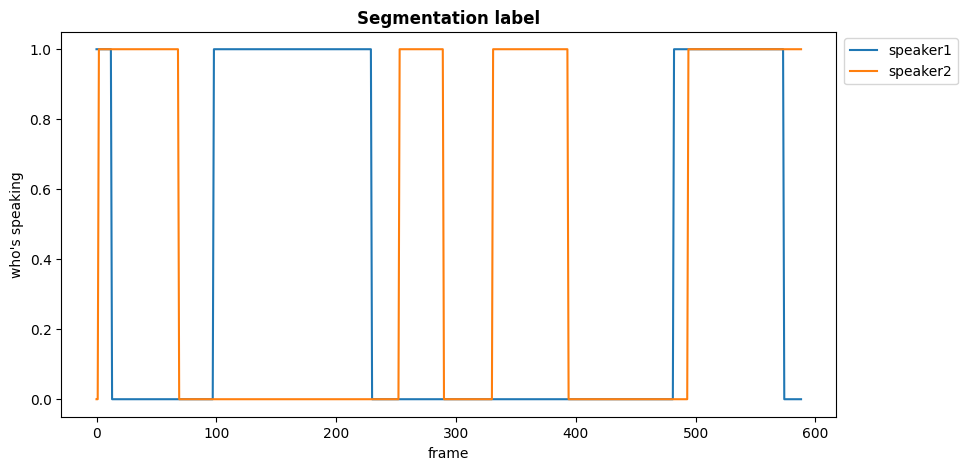

In [ ]:
import matplotlib.pyplot as plt

def plot_segmentation_labels(example):

  plt.figure(figsize = (10, 5))
  plt.plot(example2['labels'][:,0], label= 'speaker1')
  plt.plot(example2['labels'][:,1], label='speaker2')
  plt.legend(bbox_to_anchor=(1.001, 1.001))
  plt.xlabel('frame')
  plt.ylabel("who's speaking")
  plt.title('Segmentation label', fontweight="bold")
  plt.show()

plot_segmentation_labels(example2)

# Prepare Training

Once we have preprocessed the dataset, we can start preparing the training! this will include loading the proper `DataCollator`, `metrics` and `TrainingArguments`:

### Load the DataCollator

`diarizers` comes with a custom `DataCollator` adapted to the training of the segmentation model.

After preprocessing, each audio-chunk can have a different numbers of speakers: as a consequence, the segmentation labels won't have the same shapes $\textit{(num_frames, num_speakers)}$.  

The DataCollator solves this issue by dynamically padding all target tensors to `max_speakers_per_chunk` during training. It can be loaded with the following line of code:

In [ ]:
from diarizers import DataCollator

data_collator = DataCollator(max_speakers_per_chunk=model.config.max_speakers_per_chunk)

## Load the evaluation metrics

Next, we define the metrics used to evaluate the model during training: we will use the `diarisation-error-rate` (DER), which is the de-facto metric for evaluating speaker diarisation systems.

We'll also compute the `missed detection`, `false alarm` and `confusion` rates, which are inherently used to calculate the DER. More information on speaker diarisation metrics can be found in the pyannote documentation [doc](https://pyannote.github.io/pyannote-metrics/reference.html#diarization).

With `diarizers`, we can compute these metrics using the `Metrics` class:

In [ ]:
from diarizers import Metrics

metrics = Metrics(model.specifications)
metrics.metrics

{'der': DiarizationErrorRate(),
 'confusion': SpeakerConfusionRate(),
 'missed_detection': MissedDetectionRate(),
 'false_alarm': FalseAlarmRate()}

## Define the training arguments

In the final step before launching training, we define the TrainingArguments. Here, we will train the model for 5 epochs and a learning rate of 1e-3. We can play with these hyperparameters to improve the performances of the segmentation model.

In [ ]:
from transformers import TrainingArguments

training_args = TrainingArguments(
    output_dir='./speaker-segmentation-fine-tuned-callhome-jpn',
    save_strategy="epoch",
    learning_rate=1e-3,
    num_train_epochs=5,
    lr_scheduler_type="cosine",
    per_device_train_batch_size=32,
    per_device_eval_batch_size=32,
    evaluation_strategy="epoch",
    gradient_accumulation_steps=1,
    dataloader_num_workers=2,
    logging_steps=25,
    load_best_model_at_end=True,
    seed=42,
    push_to_hub=True,
)

**Note**: if one does not want to upload the model checkpoints to the Hub,
set `push_to_hub=False`.

We can forward the training arguments to the 🤗 Trainer along with our model,
dataset, data collator and metrics function:

In [ ]:
from transformers import Trainer

trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_set,
    data_collator=data_collator,
    eval_dataset=val_set,
    compute_metrics=metrics,
)

## Train

We can now launch training! it will take between 5 and 15 minutes depending on your GPU or the one allocated to this Google Colab.

First, let's evaluate the performance of the pretrained segmentation model on the val set of the Callhome japanese:

In [ ]:
first_eval = trainer.evaluate()
first_eval

{'eval_loss': 1.0462567806243896,
 'eval_der': 0.3189396560192108,
 'eval_false_alarm': 0.021168198436498642,
 'eval_missed_detection': 0.24518272280693054,
 'eval_confusion': 0.052588727325201035,
 'eval_runtime': 6.246,
 'eval_samples_per_second': 120.878,
 'eval_steps_per_second': 3.842}

We obtain a DER metric of 31%. Let's see how we can improve this metric after fine-tuning.

To launch training, simply execute:

In [ ]:
trainer.train()

Could not estimate the number of tokens of the input, floating-point operations will not be computed


Epoch,Training Loss,Validation Loss,Der,False Alarm,Missed Detection,Confusion
1,0.580000,0.758146,0.234667,0.053971,0.131273,0.049424
2,0.526500,0.755582,0.227014,0.047309,0.136895,0.042809
3,0.538800,0.773106,0.229481,0.047073,0.139052,0.043356
4,0.499100,0.758267,0.224116,0.048323,0.132371,0.043421
5,0.526000,0.757997,0.225155,0.048146,0.133166,0.043843


TrainOutput(global_step=1640, training_loss=0.5396956167569975, metrics={'train_runtime': 300.7741, 'train_samples_per_second': 174.367, 'train_steps_per_second': 5.453, 'total_flos': 0.0, 'train_loss': 0.5396956167569975, 'epoch': 5.0})

Our best DER is 22% - not bad for 5min training! We also see that the false alarm, missed detection and confusion metrics also decrease substantially.

We can make our model more accessible on the Hub with appropriate tags and README information. You can change these values to match your dataset, language and model name accordingly:

In [ ]:
kwargs = {
    "dataset_tags":'diarizers-community/callhome',
    "dataset_args": "config: jpn",
    "language": "jpn",
    "model_name": "speaker-segmentation-fine-tuned-callhome-jpn",
    "finetuned_from": "openai/whisper-small",
    "tasks": "speaker-diarization",
    "tags": ['speaker-diarization', 'speaker-segmentation']
}

The training results can now be uploaded to the Hub. In doing so, the fine-tuned model can easily be loaded by any member of the community. To do so, execute the `push_to_hub` command from the trainer:

In [ ]:
trainer.push_to_hub(**kwargs)

CommitInfo(commit_url='https://huggingface.co/kamilakesbi/speaker-segmentation-fine-tuned-callhome-jpn/commit/d04be076e0c69ee6d0efdaa0cbca89cf61de45a5', commit_message='End of training', commit_description='', oid='d04be076e0c69ee6d0efdaa0cbca89cf61de45a5', pr_url=None, pr_revision=None, pr_num=None)

# Test at inference time

Now that we have our fine-tuned segmentation model, we can convert it to a pyannote format using the following line of code:

In [ ]:
model = model.to_pyannote_model()

...and evaluate the model at inference time, on full meeting recordings!    

 For that, we can use the `Test` class from `diarizers`. Let's instanciate an object from this class: we'll need to specify the dataset we want to evaluate our model on (here the test set of callhome japanese), the segmentation model, as well as the step (in seconds) between successive $\textit{on-the-fly}$ generated audio chunks:


In [ ]:
from diarizers import Test

test = Test(dataset['test'], model, step=2.5)

In [ ]:
metrics = test.compute_metrics()
metrics

100%|██████████| 12/12 [00:28<00:00,  2.39s/it]


{'der': tensor(0.1840, device='cuda:0'),
 'false_alarm': tensor(0.0630, device='cuda:0'),
 'missed_detection': tensor(0.0705, device='cuda:0'),
 'confusion': tensor(0.0506, device='cuda:0')}

# Use in a pyannote speaker diarization pipeline

Finally, we can load the segmentation model into a `pyannote` speaker diarization pipeline:

To do so, we load the pre-trained diarization pipeline, and subsequently override the segmentation model with our fine-tuned checkpoint:

In [ ]:
import torch
from pyannote.audio import Pipeline

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

pipeline = Pipeline.from_pretrained("pyannote/speaker-diarization-3.1")
pipeline.to(device)
pipeline._segmentation.model = model.to(device)

We can then run the speaker diarization pipeline on a full meeting example: we load an example from the test set, and preprocess it to be given as input to the diarization pipeline:

Note: in this audio file\, there are only 2 speakers talking. We can specify `num_speakers=2` so that it only predicts a maximum of 2 speakers.

In [ ]:
example = dataset['test'][0]

print("Number of speaker talking in file: ", len(set(example['speakers'])))

sample = {}
sample["waveform"] = torch.from_numpy(example['audio']["array"]).to(device, dtype=model.dtype).unsqueeze(0)
sample["sample_rate"] = example['audio']['sampling_rate']

# perform inference
diarization = pipeline(sample, num_speakers=2)

Number of speaker talking in file:  2


We can now visualize the diarization results:

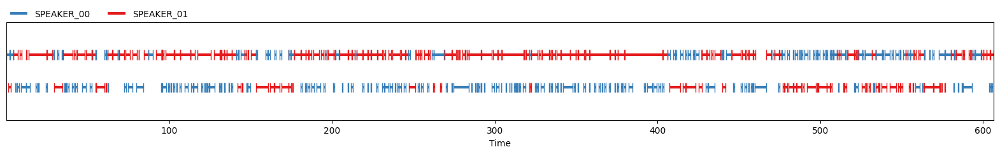

In [ ]:
diarization

...and save them in rttm format:

In [ ]:
with open("audio.rttm", "w") as rttm:
    diarization.write_rttm(rttm)

# Closing remarks

In this notebook, we covered a step-by-step guide on fine-tuning pyannote's segmentation model for multilingual speaker diarization using 🤗 diarizers. The resulting model can then be integrated into a pyannote speaker diarization  pipeline to perform diarization.

For now, our library can only be used to fine-tune the segmentation model from the speaker diarization pipeline. Future work will aim to help optimise the hyperparameters of the entire pipeline.